In [1]:
#scrapping and cleaning process

from bs4 import BeautifulSoup as BS
import requests
from requests import get
from IPython.core.display import display, HTML
import re
import pandas as pd
import numpy as np
from time import sleep
from random import randint
import dateutil.parser

#visualization

import matplotlib.pyplot as plt
import seaborn as sns
%config InlineBackend.figure_formats = ['svg']  # or svg
%matplotlib inline


# Step 2: data cleaning and preparing

### Merge tables

In [2]:
movies_crewcast.to_csv('/Users/hernantrujillo/Documents/Metis/NBM_Regression_Student-main/Movies_Project_Hernan/data_project/crew_cast_raw.csv') 

NameError: name 'movies_crewcast' is not defined

In [823]:
movies_crewcast = pd.read_csv("/Users/hernantrujillo/Documents/Metis/NBM_Regression_Student-main/Movies_Project_Hernan/data_project/crew_cast_raw.csv")

In [824]:
movies_crewcast.head()

,title,Unnamed: 0,director,actors,years
0,Toy Story 4,0,Josh Cooley,"Tom Hanks, Tim Allen, Annie Potts, Tony Hale",2019
1,The Lion King,1,"Roger Allers, Rob Minkoff","Matthew Broderick, Jeremy Irons, James Earl Jo...",1994
2,Toy Story 3,2,Lee Unkrich,"Tom Hanks, Tim Allen, Joan Cusack, Ned Beatty",2010
3,Finding Nemo,3,"Andrew Stanton, Lee Unkrich","Albert Brooks, Ellen DeGeneres, Alexander Goul...",2003
4,"Monsters, Inc.",4,"Pete Docter, David Silverman, Lee Unkrich","Billy Crystal, John Goodman, Mary Gibbs, Steve...",2001


In [825]:
movies_crewcast.groupby(by=["years"]).count()

,title,Unnamed: 0,director,actors
years,,,,
1931,1,1,1,1
1936,1,1,1,1
1937,2,2,2,2
1939,4,4,4,4
1940,4,4,4,4
...,...,...,...,...
2017,109,109,109,109
2018,111,111,111,111
2019,120,120,120,120


In [826]:
movies_crewcast.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4364 entries, 0 to 4363
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   title       4364 non-null   object
 1   Unnamed: 0  4364 non-null   int64 
 2   director    4364 non-null   object
 3   actors      4364 non-null   object
 4   years       4364 non-null   int64 
dtypes: int64(2), object(3)
memory usage: 170.6+ KB


In [827]:
#set the title as index

movies_crewcast.set_index('title', inplace=True)
movies_crewcast.head()

,Unnamed: 0,director,actors,years
title,,,,
Toy Story 4,0,Josh Cooley,"Tom Hanks, Tim Allen, Annie Potts, Tony Hale",2019
The Lion King,1,"Roger Allers, Rob Minkoff","Matthew Broderick, Jeremy Irons, James Earl Jo...",1994
Toy Story 3,2,Lee Unkrich,"Tom Hanks, Tim Allen, Joan Cusack, Ned Beatty",2010
Finding Nemo,3,"Andrew Stanton, Lee Unkrich","Albert Brooks, Ellen DeGeneres, Alexander Goul...",2003
"Monsters, Inc.",4,"Pete Docter, David Silverman, Lee Unkrich","Billy Crystal, John Goodman, Mary Gibbs, Steve...",2001


In [828]:
print(df1.shape)
print(movies_crewcast.shape)

(580, 12)
(4364, 4)


In [829]:
movies_crewcast.drop('Unnamed: 0', axis=1, inplace=True)  
movies_crewcast.head()

,director,actors,years
title,,,
Toy Story 4,Josh Cooley,"Tom Hanks, Tim Allen, Annie Potts, Tony Hale",2019
The Lion King,"Roger Allers, Rob Minkoff","Matthew Broderick, Jeremy Irons, James Earl Jo...",1994
Toy Story 3,Lee Unkrich,"Tom Hanks, Tim Allen, Joan Cusack, Ned Beatty",2010
Finding Nemo,"Andrew Stanton, Lee Unkrich","Albert Brooks, Ellen DeGeneres, Alexander Goul...",2003
"Monsters, Inc.","Pete Docter, David Silverman, Lee Unkrich","Billy Crystal, John Goodman, Mary Gibbs, Steve...",2001


In [710]:
"""string = ['William Cottrell, David Hand, Wilfred Jackson, Larry Morey, Perce Pearce, Ben Sharpsteen']
string_split_final_directors = string[0].split(", ")"""

In [711]:
"""string_split_final_directors"""

['William Cottrell',
 'David Hand',
 'Wilfred Jackson',
 'Larry Morey',
 'Perce Pearce',
 'Ben Sharpsteen']

In [714]:
"""def director_dummy(directors):
    top_directors = ["Steven Spielberg", "Robert Zemeckis", "Tim Burton"] 
    if directors.find(",") != -1:
        director_list = directors
    else:
        director_list = string[0].split(", ")
    for director in director_list:
        if director in top_directors:
            return 1
    return 0  
"""

#### Dummy Directors

In [777]:
def director_dummy(directors):
    top_directors=["Steven Spielberg", "Robert Zemeckis", "Tim Burton"]
    try:
      search = [directors.find(director) for director in top_directors]
      return int(sum (search) == -1 * len(top_directors))
    except:
      return "Error"

In [778]:
movies_crewcast['top directors'] = movies_crewcast['director'].apply(director_dummy)

In [779]:
movies_crewcast.head(20)

,director,actors,years,top directors,top_actors
title,,,,,
Toy Story 4,Josh Cooley,"Tom Hanks, Tim Allen, Annie Potts, Tony Hale",2019,1,1
The Lion King,"Roger Allers, Rob Minkoff","Matthew Broderick, Jeremy Irons, James Earl Jo...",1994,1,1
Toy Story 3,Lee Unkrich,"Tom Hanks, Tim Allen, Joan Cusack, Ned Beatty",2010,1,1
Finding Nemo,"Andrew Stanton, Lee Unkrich","Albert Brooks, Ellen DeGeneres, Alexander Goul...",2003,1,1
"Monsters, Inc.","Pete Docter, David Silverman, Lee Unkrich","Billy Crystal, John Goodman, Mary Gibbs, Steve...",2001,1,1
Monsters University,Dan Scanlon,"Billy Crystal, John Goodman, Steve Buscemi, He...",2013,1,1
Toy Story 2,"John Lasseter, Ash Brannon, Lee Unkrich","Tom Hanks, Tim Allen, Joan Cusack, Kelsey Grammer",1999,1,1
Cars,"John Lasseter, Joe Ranft","Owen Wilson, Bonnie Hunt, Paul Newman, Larry t...",2006,1,1
WALL·E,Andrew Stanton,"Ben Burtt, Elissa Knight, Jeff Garlin, Fred Wi...",2008,1,1


In [885]:
movies_crewcast.dtypes

director    object
actors      object
years        int64
dtype: object

In [878]:
director_list = (movies_crewcast['director']) #.str.cat(sep=' ')).replace('[','').replace(']','').replace("'",'').replace(",",'')

director_unique = list(set(director_list)) #.split()))

In [888]:
director_unique.split()

AttributeError: 'list' object has no attribute 'split'

In [895]:
movies_crew_cast = pd.read_csv('/Users/hernantrujillo/Documents/Metis/NBM_Regression_Student-main/Movies_Project_Hernan/data_project/movies_crewcast.csv')

In [896]:
movies_crew_cast

,title,director,actors,years
0,Toy Story 4,Josh Cooley,"Tom Hanks, Tim Allen, Annie Potts, Tony Hale",2019
1,The Lion King,"Roger Allers, Rob Minkoff","Matthew Broderick, Jeremy Irons, James Earl Jo...",1994
2,Toy Story 3,Lee Unkrich,"Tom Hanks, Tim Allen, Joan Cusack, Ned Beatty",2010
3,Finding Nemo,"Andrew Stanton, Lee Unkrich","Albert Brooks, Ellen DeGeneres, Alexander Goul...",2003
4,"Monsters, Inc.","Pete Docter, David Silverman, Lee Unkrich","Billy Crystal, John Goodman, Mary Gibbs, Steve...",2001
...,...,...,...,...
1027,Elles,Malgorzata Szumowska,"Juliette Binoche, Anaïs Demoustier, Joanna Kul...",2011
1028,Law of Desire,Pedro Almodóvar,"Eusebio Poncela, Carmen Maura, Antonio Bandera...",1987
1029,Ma mère,Christophe Honoré,"Isabelle Huppert, Louis Garrel, Emma de Caunes...",2004
1030,"Paris, France",Jerry Ciccoritti,"Leslie Hope, Peter Outerbridge, Victor Ertmani...",1993


In [897]:
movies_crew_cast['director'] = movies_crew_cast.director.apply(lambda x: x[0:-1].split(','))

In [898]:
movies_crew_cast

,title,director,actors,years
0,Toy Story 4,[Josh Coole],"Tom Hanks, Tim Allen, Annie Potts, Tony Hale",2019
1,The Lion King,"[Roger Allers, Rob Minkof]","Matthew Broderick, Jeremy Irons, James Earl Jo...",1994
2,Toy Story 3,[Lee Unkric],"Tom Hanks, Tim Allen, Joan Cusack, Ned Beatty",2010
3,Finding Nemo,"[Andrew Stanton, Lee Unkric]","Albert Brooks, Ellen DeGeneres, Alexander Goul...",2003
4,"Monsters, Inc.","[Pete Docter, David Silverman, Lee Unkric]","Billy Crystal, John Goodman, Mary Gibbs, Steve...",2001
...,...,...,...,...
1027,Elles,[Malgorzata Szumowsk],"Juliette Binoche, Anaïs Demoustier, Joanna Kul...",2011
1028,Law of Desire,[Pedro Almodóva],"Eusebio Poncela, Carmen Maura, Antonio Bandera...",1987
1029,Ma mère,[Christophe Honor],"Isabelle Huppert, Louis Garrel, Emma de Caunes...",2004
1030,"Paris, France",[Jerry Ciccoritt],"Leslie Hope, Peter Outerbridge, Victor Ertmani...",1993


In [879]:
string_split_final_directors = director_list[0].split(", ")

In [880]:
"""    for title in title_text.split("\n"):
        titles.append(title)

    return(titles)"""

for director in director_unique:
    new_directors = []
    new_directors.append(director)
    
print(new_directors)

['David Silverman']


In [858]:
#director_list[:]                   #= director_list[0].split(", ")

title
Toy Story 4                                               Josh Cooley
The Lion King                               Roger Allers, Rob Minkoff
Toy Story 3                                               Lee Unkrich
Finding Nemo                              Andrew Stanton, Lee Unkrich
Monsters, Inc.              Pete Docter, David Silverman, Lee Unkrich
                                              ...                    
Hannibal Rising                                          Peter Webber
Cadillac Man                                          Roger Donaldson
Do the Right Thing                                          Spike Lee
Poetic Justice                                         John Singleton
Three Days of the Condor                               Sydney Pollack
Name: director, Length: 4364, dtype: object

In [782]:
from collections import Counter
director_counter = Counter(director_list)
most_popular_directors = (director_counter.most_common())
most_popular_directors


[('Steven Spielberg', 21),
 ('Robert Zemeckis', 14),
 ('Tim Burton', 10),
 ('George Lucas', 9),
 ('Chris Columbus', 9),
 ('Jon Favreau', 8),
 ('Ron Howard', 8),
 ('Shawn Levy', 8),
 ('Michael Bay', 8),
 ('David Yates', 7),
 ('Peter Jackson', 7),
 ('Carlos Saldanha', 6),
 ('Sam Raimi', 6),
 ('Rob Marshall', 6),
 ('Genndy Tartakovsky', 6),
 ('Richard Donner', 6),
 ('Christopher Nolan', 6),
 ('Bryan Singer', 6),
 ('Ridley Scott', 6),
 ('Ron Clements, John Musker', 5),
 ('Mike Mitchell', 5),
 ('Garry Marshall', 5),
 ('James Cameron', 5),
 ('Brad Bird', 5),
 ('Ivan Reitman', 5),
 ('Jon Turteltaub', 5),
 ('Tony Scott', 5),
 ('Steve Carr', 5),
 ('Sylvester Stallone', 5),
 ('Gore Verbinski', 5),
 ('Adam Shankman', 5),
 ('Zack Snyder', 5),
 ('Sam Mendes', 5),
 ('Clint Eastwood', 5),
 ('Todd Phillips', 5),
 ('Kevin Lima', 4),
 ('Vincent McEveety', 4),
 ('Tim Hill', 4),
 ('Bill Condon', 4),
 ('Chris Buck, Jennifer Lee', 4),
 ('Pierre Coffin, Chris Renaud', 4),
 ('Guy Ritchie', 4),
 ('Andrew Adams

#### Dummy Actors

In [783]:
actors_list = (movies_crewcast['actors']) #.str.cat(sep=' ')).replace('[','').replace(']','').replace("'",'').replace(",",'')
actors_unique = list(set(actors_list)) #.split()))
actors_list

title
Toy Story 4                      Tom Hanks, Tim Allen, Annie Potts, Tony Hale
The Lion King               Matthew Broderick, Jeremy Irons, James Earl Jo...
Toy Story 3                     Tom Hanks, Tim Allen, Joan Cusack, Ned Beatty
Finding Nemo                Albert Brooks, Ellen DeGeneres, Alexander Goul...
Monsters, Inc.              Billy Crystal, John Goodman, Mary Gibbs, Steve...
                                                  ...                        
Elles                       Juliette Binoche, Anaïs Demoustier, Joanna Kul...
Law of Desire               Eusebio Poncela, Carmen Maura, Antonio Bandera...
Ma mère                     Isabelle Huppert, Louis Garrel, Emma de Caunes...
Paris, France               Leslie Hope, Peter Outerbridge, Victor Ertmani...
This Ones for the Ladies    Lakia Hunter, Michele Moore, Poundcake, Terril...
Name: actors, Length: 1032, dtype: object

In [5]:
from collections import Counter
actors_counter = Counter(actors_list)
most_popular_actors = (actors_counter.most_common())
most_popular_actors.split(", ")

NameError: name 'actors_list' is not defined

In [785]:
def actors_dummy(actors):
    top_actors=["Sylvester Stallone", "Harrison Ford", "Tom Hanks"]
    try:
      search = [actors.find(actors) for actor in top_actors]
      return int(sum (search) == -1 * len(top_actors))
    except:
      return "Error"

In [787]:
movies_crewcast['top_actors'] = movies_crewcast['actors'].apply(actors_dummy)
movies_crewcast.head(20)

,director,actors,years,top directors,top_actors
title,,,,,
Toy Story 4,Josh Cooley,"Tom Hanks, Tim Allen, Annie Potts, Tony Hale",2019,1,0
The Lion King,"Roger Allers, Rob Minkoff","Matthew Broderick, Jeremy Irons, James Earl Jo...",1994,1,0
Toy Story 3,Lee Unkrich,"Tom Hanks, Tim Allen, Joan Cusack, Ned Beatty",2010,1,0
Finding Nemo,"Andrew Stanton, Lee Unkrich","Albert Brooks, Ellen DeGeneres, Alexander Goul...",2003,1,0
"Monsters, Inc.","Pete Docter, David Silverman, Lee Unkrich","Billy Crystal, John Goodman, Mary Gibbs, Steve...",2001,1,0
Monsters University,Dan Scanlon,"Billy Crystal, John Goodman, Steve Buscemi, He...",2013,1,0
Toy Story 2,"John Lasseter, Ash Brannon, Lee Unkrich","Tom Hanks, Tim Allen, Joan Cusack, Kelsey Grammer",1999,1,0
Cars,"John Lasseter, Joe Ranft","Owen Wilson, Bonnie Hunt, Paul Newman, Larry t...",2006,1,0
WALL·E,Andrew Stanton,"Ben Burtt, Elissa Knight, Jeff Garlin, Fred Wi...",2008,1,0


## Lets get rid of the null values

In [77]:
# Inspection

df1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1000 entries, Avengers: Endgame to Meru
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   budget           596 non-null    float64       
 1   runtime          972 non-null    float64       
 2   rating           949 non-null    object        
 3   genres           1000 non-null   object        
 4   distributor      999 non-null    object        
 5   domestic_gross   1000 non-null   int64         
 6   worldwide_gross  1000 non-null   int64         
 7   opening_gross    992 non-null    float64       
 8   widest_release   1000 non-null   int64         
 9   release_date     1000 non-null   datetime64[ns]
 10  season           1000 non-null   object        
dtypes: datetime64[ns](1), float64(3), int64(3), object(4)
memory usage: 93.8+ KB


In [78]:
#identify total null values

df1.isna().sum() 

budget             404
runtime             28
rating              51
genres               0
distributor          1
domestic_gross       0
worldwide_gross      0
opening_gross        8
widest_release       0
release_date         0
season               0
dtype: int64

## Dropping null values

#### no rating (some movies don't have a rating)
#### no budget (missing values / the mean of the movies is too high -about 60MM- and zero value is not an option) 
#### no runtimes (missing values)
#### no distributor (outlier)

In [79]:
df1 = df1.dropna()

In [80]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 580 entries, Avengers: Endgame to Horrible Bosses 2
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   budget           580 non-null    float64       
 1   runtime          580 non-null    float64       
 2   rating           580 non-null    object        
 3   genres           580 non-null    object        
 4   distributor      580 non-null    object        
 5   domestic_gross   580 non-null    int64         
 6   worldwide_gross  580 non-null    int64         
 7   opening_gross    580 non-null    float64       
 8   widest_release   580 non-null    int64         
 9   release_date     580 non-null    datetime64[ns]
 10  season           580 non-null    object        
dtypes: datetime64[ns](1), float64(3), int64(3), object(4)
memory usage: 54.4+ KB


In [81]:
# Lets convert float values to integers

In [82]:
#budget from float to integers
df1["budget"] = df1.budget.astype(int)

<ipython-input-82-5157cd494495>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1["budget"] = df1.budget.astype(int)


In [83]:
#runtime_minutes from float to integers
df1["runtime"] = df1.runtime.astype(int)

<ipython-input-83-0fab9d88e79c>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1["runtime"] = df1.runtime.astype(int)


In [84]:
#opening_gross from float to integers
df1["opening_gross"] = df1.opening_gross.astype(int)

<ipython-input-84-f4336c8d7d4a>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1["opening_gross"] = df1.opening_gross.astype(int)


In [85]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 580 entries, Avengers: Endgame to Horrible Bosses 2
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   budget           580 non-null    int64         
 1   runtime          580 non-null    int64         
 2   rating           580 non-null    object        
 3   genres           580 non-null    object        
 4   distributor      580 non-null    object        
 5   domestic_gross   580 non-null    int64         
 6   worldwide_gross  580 non-null    int64         
 7   opening_gross    580 non-null    int64         
 8   widest_release   580 non-null    int64         
 9   release_date     580 non-null    datetime64[ns]
 10  season           580 non-null    object        
dtypes: datetime64[ns](1), int64(6), object(4)
memory usage: 54.4+ KB


In [86]:
df1['release_date'] = pd.to_datetime(df1['release_date'])

df1['year'] = df1['release_date'].dt.year

<ipython-input-86-50055c5123a5>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1['release_date'] = pd.to_datetime(df1['release_date'])
<ipython-input-86-50055c5123a5>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1['year'] = df1['release_date'].dt.year


In [87]:
df1.head()

,budget,runtime,rating,genres,distributor,domestic_gross,worldwide_gross,opening_gross,widest_release,release_date,season,year
title,,,,,,,,,,,,
Avengers: Endgame,356000000,181,PG-13,Action Adventure Drama Sci-Fi,Walt Disney Studios Motion Pictures,858373000,2797501328,357115007,4662,2019-04-26,Spring,2019
The Lion King,260000000,118,PG,Adventure Animation Drama Family Musical,Walt Disney Studios Motion Pictures,543638043,1656943394,191770759,4802,2019-07-19,Summer,2019
Toy Story 4,200000000,100,G,Adventure Animation Comedy Family Fantasy,Walt Disney Studios Motion Pictures,434038008,1073394593,120908065,4575,2019-06-21,Summer,2019
Frozen II,150000000,103,PG,Adventure Animation Comedy Family Fantasy Musical,Walt Disney Studios Motion Pictures,477373578,1450026933,130263358,4440,2019-11-22,Fall,2019
Captain Marvel,160000000,123,PG-13,Action Adventure Sci-Fi,Walt Disney Studios Motion Pictures,426829839,1128274794,153433423,4310,2019-03-08,Spring,2019


In [88]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 580 entries, Avengers: Endgame to Horrible Bosses 2
Data columns (total 12 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   budget           580 non-null    int64         
 1   runtime          580 non-null    int64         
 2   rating           580 non-null    object        
 3   genres           580 non-null    object        
 4   distributor      580 non-null    object        
 5   domestic_gross   580 non-null    int64         
 6   worldwide_gross  580 non-null    int64         
 7   opening_gross    580 non-null    int64         
 8   widest_release   580 non-null    int64         
 9   release_date     580 non-null    datetime64[ns]
 10  season           580 non-null    object        
 11  year             580 non-null    int64         
dtypes: datetime64[ns](1), int64(7), object(4)
memory usage: 58.9+ KB


In [6]:
df1.to_csv("/Users/hernantrujillo/Documents/Metis/NBM_Regression_Student-main/Movies_Project_Hernan/data_project/df1.csv")

NameError: name 'df1' is not defined

In [208]:
df2 = pd.read_csv("/Users/hernantrujillo/Documents/Metis/NBM_Regression_Student-main/Movies_Project_Hernan/data_project/df1.csv")

In [7]:
df2.head()

NameError: name 'df2' is not defined

In [94]:
df2.groupby(["year"]).count() #there are 17 movies that were originally released in 2014 in other regions and are included in our 5 years data. We will keep it.

,title,budget,runtime,rating,genres,distributor,domestic_gross,worldwide_gross,opening_gross,widest_release,release_date,season
year,,,,,,,,,,,,
2014,17,17,17,17,17,17,17,17,17,17,17,17
2015,121,121,121,121,121,121,121,121,121,121,121,121
2016,122,122,122,122,122,122,122,122,122,122,122,122
2017,106,106,106,106,106,106,106,106,106,106,106,106
2018,106,106,106,106,106,106,106,106,106,106,106,106
2019,108,108,108,108,108,108,108,108,108,108,108,108


In [434]:
df2.year.tail(20) # most of them by the end of 2014 (Fall and Winter)

title
The Gunman                                        2015
Unfinished Business                               2015
The Walk                                          2015
Penguins of Madagascar                            2014
Exodus: Gods and Kings                            2014
Huevos: Little Rooster's Egg-cellent Adventure    2015
Interstellar                                      2014
Blackhat                                          2015
Mortdecai                                         2015
Whiplash                                          2014
The Green Inferno                                 2015
Our Brand Is Crisis                               2015
Grandma                                           2015
Me and Earl and the Dying Girl                    2015
A Most Violent Year                               2014
Danny Collins                                     2015
90 Minutes in Heaven                              2015
The Water Diviner                                 2015
Scou

# Let's start transforming categorical values into numerical values using Dummies

# Genres

In [211]:
df2.set_index('title', inplace=True)
df2.head()

,budget,runtime,rating,genres,distributor,domestic_gross,worldwide_gross,opening_gross,widest_release,release_date,season,year
title,,,,,,,,,,,,
Avengers: Endgame,356000000,181,PG-13,Action Adventure Drama Sci-Fi,Walt Disney Studios Motion Pictures,858373000,2797501328,357115007,4662,2019-04-26,Spring,2019
The Lion King,260000000,118,PG,Adventure Animation Drama Family Musical,Walt Disney Studios Motion Pictures,543638043,1656943394,191770759,4802,2019-07-19,Summer,2019
Toy Story 4,200000000,100,G,Adventure Animation Comedy Family Fantasy,Walt Disney Studios Motion Pictures,434038008,1073394593,120908065,4575,2019-06-21,Summer,2019
Frozen II,150000000,103,PG,Adventure Animation Comedy Family Fantasy Musical,Walt Disney Studios Motion Pictures,477373578,1450026933,130263358,4440,2019-11-22,Fall,2019
Captain Marvel,160000000,123,PG-13,Action Adventure Sci-Fi,Walt Disney Studios Motion Pictures,426829839,1128274794,153433423,4310,2019-03-08,Spring,2019


In [212]:
df2.shape

(580, 12)

In [213]:
#Let's check combinated genres values

genres_count = df2['genres'].value_counts()

In [214]:
genres_count

Action Adventure Sci-Fi                          29
Horror Mystery Thriller                          23
Comedy                                           18
Comedy Drama                                     14
Drama                                            13
                                                 ..
Action Biography Drama Sport War                  1
Action Comedy Horror Mystery Thriller             1
Biography Comedy Drama War                        1
Drama Fantasy Romance                             1
Action Adventure Comedy Family Mystery Sci-Fi     1
Name: genres, Length: 240, dtype: int64

In [220]:
df2.columns

Index(['budget', 'runtime', 'rating', 'genres', 'distributor',
       'domestic_gross', 'worldwide_gross', 'opening_gross', 'widest_release',
       'release_date', 'season', 'year'],
      dtype='object')

In [221]:
#it doens't work since there are genres combinated. We will do it creating functions

pd.get_dummies(df2['genres'], drop_first=True).head()

,Action Adventure Animation Comedy Family Fantasy,Action Adventure Animation Comedy Family Fantasy Musical,Action Adventure Animation Comedy Family Fantasy Musical Sci-Fi,Action Adventure Animation Comedy Family Sci-Fi,Action Adventure Animation Drama Family Fantasy,Action Adventure Animation Family Fantasy,Action Adventure Animation Family Fantasy Sci-Fi,Action Adventure Animation Family Sci-Fi,Action Adventure Biography Drama,Action Adventure Biography Drama History,...,Drama Thriller,Family Fantasy Musical Romance,Fantasy Horror Mystery Thriller,Horror,Horror Mystery,Horror Mystery Sci-Fi Thriller,Horror Mystery Thriller,Horror Sci-Fi Thriller,Horror Thriller,Thriller
title,,,,,,,,,,,,,,,,,,,,,
Avengers: Endgame,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
The Lion King,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Toy Story 4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Frozen II,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Captain Marvel,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [222]:
df2.genres.unique()

array(['Action Adventure Drama Sci-Fi',
       'Adventure Animation Drama Family Musical',
       'Adventure Animation Comedy Family Fantasy',
       'Adventure Animation Comedy Family Fantasy Musical',
       'Action Adventure Sci-Fi', 'Action Adventure Fantasy Sci-Fi',
       'Adventure Family Fantasy Musical Romance', 'Crime Drama Thriller',
       'Drama Fantasy Horror', 'Action Adventure Comedy Fantasy',
       'Horror Mystery Thriller', 'Action Crime Thriller',
       'Action Adventure Animation Drama Family Fantasy',
       'Adventure Animation Comedy Family',
       'Action Adventure Comedy Family Mystery Sci-Fi', 'Comedy Drama',
       'Comedy Crime Drama Mystery Thriller', 'Adventure Family Fantasy',
       'Drama Sci-Fi Thriller', 'Action Biography Drama Sport',
       'Action Adventure Animation Comedy Family Fantasy Musical',
       'Comedy Crime Drama', 'Animation Comedy Family Fantasy Horror',
       'Drama Romance', 'Biography Drama Music Musical',
       'Action Advent

In [223]:
genres_types_list = (df2['genres'].str.cat(sep=' ')).replace('[','').replace(']','').replace("'",'').replace(",",'')

genres_types_unique = list(set(genres_types_list.split()))

In [224]:
genres_types_list = genres_types_list.split()

In [225]:
from collections import Counter
c = Counter(genres_types_list)
print(c.most_common())


[('Drama', 266), ('Comedy', 221), ('Action', 215), ('Adventure', 198), ('Thriller', 188), ('Sci-Fi', 120), ('Fantasy', 118), ('Crime', 98), ('Family', 91), ('Horror', 86), ('Mystery', 81), ('Romance', 62), ('Biography', 59), ('Animation', 57), ('History', 30), ('Music', 24), ('Musical', 23), ('War', 18), ('Sport', 17), ('Western', 8), ('Documentary', 3)]


In [274]:
def comedy(genres):
    if 'Comedy' in genres:
        return 1
    else:
        return 0

In [275]:
def adventure(genres):
    if 'Adventure' in genres:
        return 1
    else:
        return 0

In [276]:
"""def musical(genres):
    if 'Musical' in genres:
        return 1
    else:
        return 0"""

"def musical(genres):\n    if 'Musical' in genres:\n        return 1\n    else:\n        return 0"

In [277]:
"""def history(genres):
    if 'History' in genres:
        return 1
    else:
        return 0"""

"def history(genres):\n    if 'History' in genres:\n        return 1\n    else:\n        return 0"

In [278]:
def thriller(genres):
    if 'Thriller' in genres:
        return 1
    else:
        return 0

In [279]:
"""def music(genres):
    if 'Music' in genres:
        return 1
    else:
        return 0"""

"def music(genres):\n    if 'Music' in genres:\n        return 1\n    else:\n        return 0"

In [280]:
def animation(genres):
    if 'Animation' in genres:
        return 1
    else:
        return 0

In [281]:
"""def war(genres):
    if 'War' in genres:
        return 1
    else:
        return 0"""

"def war(genres):\n    if 'War' in genres:\n        return 1\n    else:\n        return 0"

In [282]:
def sci_fi(genres):
    if 'Sci-Fi' in genres:
        return 1
    else:
        return 0

In [283]:
def family(genres):
    if 'Family' in genres:
        return 1
    else:
        return 0

In [284]:
def horror(genres):
    if 'Horror' in genres:
        return 1
    else:
        return 0

In [285]:
def crime(genres):
    if 'Crime' in genres:
        return 1
    else:
        return 0

In [286]:
def fantasy(genres):
    if 'Fantasy' in genres:
        return 1
    else:
        return 0

In [287]:
"""def documentary(genres):
    if 'Documentary' in genres:
        return 1
    else:
        return 0"""

"def documentary(genres):\n    if 'Documentary' in genres:\n        return 1\n    else:\n        return 0"

In [288]:
def biography(genres):
    if 'Biography' in genres:
        return 1
    else:
        return 0

In [289]:
def action(genres):
    if 'Action' in genres:
        return 1
    else:
        return 0

In [290]:
def romance(genres):
    if 'Romance' in genres:
        return 1
    else:
        return 0

In [291]:
def mystery(genres):
    if 'Mystery' in genres:
        return 1
    else:
        return 0

In [292]:
"""def sport(genres):
    if 'Sport' in genres:
        return 1
    else:
        return 0"""

"def sport(genres):\n    if 'Sport' in genres:\n        return 1\n    else:\n        return 0"

In [293]:
"""def western(genres):
    if 'Western' in genres:
        return 1
    else:
        return 0"""

"def western(genres):\n    if 'Western' in genres:\n        return 1\n    else:\n        return 0"

In [294]:
def drama(genres):
    if 'Drama' in genres:
        return 1
    else:
        return 0

In [317]:
#Most popular genres
c = Counter(genres_types_list)
print(c.most_common())

[('Drama', 266), ('Comedy', 221), ('Action', 215), ('Adventure', 198), ('Thriller', 188), ('Sci-Fi', 120), ('Fantasy', 118), ('Crime', 98), ('Family', 91), ('Horror', 86), ('Mystery', 81), ('Romance', 62), ('Biography', 59), ('Animation', 57), ('History', 30), ('Music', 24), ('Musical', 23), ('War', 18), ('Sport', 17), ('Western', 8), ('Documentary', 3)]


In [295]:
def others_genre(genres):
    if 'History' in genres:
        return 1
    elif 'Music' in genres:
        return 1
    elif 'Musical' in genres:
        return 1
    elif 'War' in genres:
        return 1
    elif 'Sport' in genres:
        return 1
    elif 'Western' in genres:
        return 1
    elif 'Documentary' in genres:
        return 1
    else:
        return 0

In [296]:
df2['genre_comedy'] = df2['genres'].apply(comedy)
df2['genre_adventure'] = df2['genres'].apply(adventure)
#df2['genre_musical'] = df2['genres'].apply(musical)
#df2['genre_history'] = df2['genres'].apply(history)
df2['genre_thriller'] = df2['genres'].apply(thriller)
#df2['genre_music'] = df2['genres'].apply(music)
df2['genre_animation'] = df2['genres'].apply(animation)
#df2['genre_war'] = df2['genres'].apply(war)
df2['genre_sci_fi'] = df2['genres'].apply(sci_fi)
df2['genre_family'] = df2['genres'].apply(family)
df2['genre_horror'] = df2['genres'].apply(horror)
df2['genre_crime'] = df2['genres'].apply(crime)
df2['genre_fantasy'] = df2['genres'].apply(fantasy)
#df2['genre_documentary'] = df2['genres'].apply(documentary)
df2['genre_biography'] = df2['genres'].apply(biography)
df2['genre_action'] = df2['genres'].apply(action)
df2['genre_romance'] = df2['genres'].apply(romance)
df2['genre_mystery'] = df2['genres'].apply(mystery)
#df2['genre_sport'] = df2['genres'].apply(sport)
#df2['genre_western'] = df2['genres'].apply(western)
df2['genre_drama'] = df2['genres'].apply(drama)
df2['others_genre'] = df2['genres'].apply(others_genre)

In [316]:
df2.others_genre.sum()

105

In [318]:
df1.shape

(580, 12)

In [319]:
df2.columns

Index(['budget', 'runtime', 'rating', 'genres', 'distributor',
       'domestic_gross', 'worldwide_gross', 'opening_gross', 'widest_release',
       'release_date', 'season', 'year', 'genre_comedy', 'genre_adventure',
       'genre_musical', 'genre_history', 'genre_thriller', 'genre_music',
       'genre_animation', 'genre_war', 'genre_sci_fi', 'genre_family',
       'genre_horror', 'genre_crime', 'genre_fantasy', 'genre_documentary',
       'genre_biography', 'genre_action', 'genre_romance', 'genre_mystery',
       'genre_sport', 'genre_western', 'genre_drama', 'others_genre'],
      dtype='object')

In [324]:
df2.drop(['genres', 'genre_musical', 'genre_history', 'genre_music', 'genre_war', 'genre_documentary', 'genre_sport', 'genre_western'], axis=1, inplace=True)
df2.shape

(580, 26)

In [343]:
df2.others_genre.sum()

105

In [325]:
df2.head()

,budget,runtime,rating,distributor,domestic_gross,worldwide_gross,opening_gross,widest_release,release_date,season,...,genre_family,genre_horror,genre_crime,genre_fantasy,genre_biography,genre_action,genre_romance,genre_mystery,genre_drama,others_genre
title,,,,,,,,,,,,,,,,,,,,,
Avengers: Endgame,356000000,181,PG-13,Walt Disney Studios Motion Pictures,858373000,2797501328,357115007,4662,2019-04-26,Spring,...,0,0,0,0,0,1,0,0,1,0
The Lion King,260000000,118,PG,Walt Disney Studios Motion Pictures,543638043,1656943394,191770759,4802,2019-07-19,Summer,...,1,0,0,0,0,0,0,0,1,1
Toy Story 4,200000000,100,G,Walt Disney Studios Motion Pictures,434038008,1073394593,120908065,4575,2019-06-21,Summer,...,1,0,0,1,0,0,0,0,0,0
Frozen II,150000000,103,PG,Walt Disney Studios Motion Pictures,477373578,1450026933,130263358,4440,2019-11-22,Fall,...,1,0,0,1,0,0,0,0,0,1
Captain Marvel,160000000,123,PG-13,Walt Disney Studios Motion Pictures,426829839,1128274794,153433423,4310,2019-03-08,Spring,...,0,0,0,0,0,1,0,0,0,0


# Distributors

In [326]:
#Let's check distributor values

dist_quantity = df2['distributor'].value_counts()
dist_quantity.head(20)

Warner Bros.                             87
Universal Pictures                       84
Twentieth Century Fox                    72
Paramount Pictures                       57
Sony Pictures Entertainment (SPE)        54
Lionsgate                                47
Walt Disney Studios Motion Pictures      44
STX Entertainment                        23
Screen Gems                              13
Focus Features                           11
Open Road Films (II)                      9
The Weinstein Company                     8
A24                                       7
Fox Searchlight Pictures                  6
Roadside Attractions                      5
BH Tilt                                   5
TriStar Pictures                          5
Metro-Goldwyn-Mayer (MGM)                 5
United Artists Releasing                  4
Entertainment Studios Motion Pictures     4
Name: distributor, dtype: int64

In [327]:
# Now, let's group distributors with less than 5 movies to get rid of the outliers

dist_quantity[dist_quantity <= 5].sum()

58

In [328]:
other_dist = list(dist_quantity[dist_quantity<=5].index)
Counter(other_dist)

Counter({'Roadside Attractions': 1,
         'BH Tilt': 1,
         'TriStar Pictures': 1,
         'Metro-Goldwyn-Mayer (MGM)': 1,
         'United Artists Releasing': 1,
         'Entertainment Studios Motion Pictures': 1,
         'Broad Green Pictures': 1,
         'Sony Pictures Classics': 1,
         'Affirm Films': 1,
         'Aviron Pictures': 1,
         'Studio 8': 1,
         'Bleecker Street Media': 1,
         'Relativity Media': 1,
         'Orion Pictures': 1,
         'EuropaCorp': 1,
         'The Samuel Goldwyn Company': 1,
         'FUNimation Entertainment': 1,
         'Quality Flix': 1,
         'Pure Flix Entertainment': 1,
         'OTL Releasing': 1,
         'Dimension Films': 1,
         'Annapurna Pictures': 1,
         'Pantelion Films': 1,
         'Neon': 1,
         'Cinelou Films': 1})

In [330]:
#Let's name them, "Other Dist"

df3 = df2.copy()
df3['distributor'] = df2['distributor'].replace(other_dist, 'Other Dist')

In [331]:
df3.tail()

,budget,runtime,rating,distributor,domestic_gross,worldwide_gross,opening_gross,widest_release,release_date,season,...,genre_family,genre_horror,genre_crime,genre_fantasy,genre_biography,genre_action,genre_romance,genre_mystery,genre_drama,others_genre
title,,,,,,,,,,,,,,,,,,,,,
Danny Collins,10000000,106,R,Other Dist,5637066,10835752,72459,739,2015-03-20,Spring,...,0,0,0,0,1,0,0,0,1,1
90 Minutes in Heaven,5000000,121,PG-13,Other Dist,4842699,4842699,2035273,899,2015-09-11,Fall,...,0,0,0,0,0,0,0,0,1,0
The Water Diviner,22500000,111,R,Warner Bros.,4196641,38176317,1220335,385,2015-04-24,Spring,...,0,0,0,0,0,0,0,0,1,1
Scouts Guide to the Zombie Apocalypse,15000000,93,R,Paramount Pictures,3703046,16137046,1841007,1509,2015-10-30,Fall,...,0,1,0,0,0,1,0,0,0,0
Horrible Bosses 2,42000000,108,R,Warner Bros.,54445357,107645357,15457418,3400,2014-11-26,Fall,...,0,0,1,0,0,0,0,0,0,0


In [332]:
df3.shape

(580, 26)

In [334]:
df3.columns

Index(['budget', 'runtime', 'rating', 'distributor', 'domestic_gross',
       'worldwide_gross', 'opening_gross', 'widest_release', 'release_date',
       'season', 'year', 'genre_comedy', 'genre_adventure', 'genre_thriller',
       'genre_animation', 'genre_sci_fi', 'genre_family', 'genre_horror',
       'genre_crime', 'genre_fantasy', 'genre_biography', 'genre_action',
       'genre_romance', 'genre_mystery', 'genre_drama', 'others_genre'],
      dtype='object')

In [336]:
df2['distributor'].value_counts()

Warner Bros.                             87
Universal Pictures                       84
Twentieth Century Fox                    72
Paramount Pictures                       57
Sony Pictures Entertainment (SPE)        54
Lionsgate                                47
Walt Disney Studios Motion Pictures      44
STX Entertainment                        23
Screen Gems                              13
Focus Features                           11
Open Road Films (II)                      9
The Weinstein Company                     8
A24                                       7
Fox Searchlight Pictures                  6
Roadside Attractions                      5
BH Tilt                                   5
TriStar Pictures                          5
Metro-Goldwyn-Mayer (MGM)                 5
United Artists Releasing                  4
Entertainment Studios Motion Pictures     4
Broad Green Pictures                      3
Sony Pictures Classics                    3
Affirm Films                    

In [337]:
#verify if Other becomes an outlier

df3['distributor'].value_counts()

Warner Bros.                           87
Universal Pictures                     84
Twentieth Century Fox                  72
Other Dist                             58
Paramount Pictures                     57
Sony Pictures Entertainment (SPE)      54
Lionsgate                              47
Walt Disney Studios Motion Pictures    44
STX Entertainment                      23
Screen Gems                            13
Focus Features                         11
Open Road Films (II)                    9
The Weinstein Company                   8
A24                                     7
Fox Searchlight Pictures                6
Name: distributor, dtype: int64

In [338]:
print(df2.shape)
print(df3.shape)

(580, 26)
(580, 26)


#### Distributor dummy

In [339]:
df4 = pd.get_dummies(df3, columns=['distributor'], drop_first=True)

In [340]:
df4.shape

(580, 39)

In [341]:
df4.head()

,budget,runtime,rating,domestic_gross,worldwide_gross,opening_gross,widest_release,release_date,season,year,...,distributor_Other Dist,distributor_Paramount Pictures,distributor_STX Entertainment,distributor_Screen Gems,distributor_Sony Pictures Entertainment (SPE),distributor_The Weinstein Company,distributor_Twentieth Century Fox,distributor_Universal Pictures,distributor_Walt Disney Studios Motion Pictures,distributor_Warner Bros.
title,,,,,,,,,,,,,,,,,,,,,
Avengers: Endgame,356000000,181,PG-13,858373000,2797501328,357115007,4662,2019-04-26,Spring,2019,...,0,0,0,0,0,0,0,0,1,0
The Lion King,260000000,118,PG,543638043,1656943394,191770759,4802,2019-07-19,Summer,2019,...,0,0,0,0,0,0,0,0,1,0
Toy Story 4,200000000,100,G,434038008,1073394593,120908065,4575,2019-06-21,Summer,2019,...,0,0,0,0,0,0,0,0,1,0
Frozen II,150000000,103,PG,477373578,1450026933,130263358,4440,2019-11-22,Fall,2019,...,0,0,0,0,0,0,0,0,1,0
Captain Marvel,160000000,123,PG-13,426829839,1128274794,153433423,4310,2019-03-08,Spring,2019,...,0,0,0,0,0,0,0,0,1,0


In [342]:
df4.columns

Index(['budget', 'runtime', 'rating', 'domestic_gross', 'worldwide_gross',
       'opening_gross', 'widest_release', 'release_date', 'season', 'year',
       'genre_comedy', 'genre_adventure', 'genre_thriller', 'genre_animation',
       'genre_sci_fi', 'genre_family', 'genre_horror', 'genre_crime',
       'genre_fantasy', 'genre_biography', 'genre_action', 'genre_romance',
       'genre_mystery', 'genre_drama', 'others_genre',
       'distributor_Focus Features', 'distributor_Fox Searchlight Pictures',
       'distributor_Lionsgate', 'distributor_Open Road Films (II)',
       'distributor_Other Dist', 'distributor_Paramount Pictures',
       'distributor_STX Entertainment', 'distributor_Screen Gems',
       'distributor_Sony Pictures Entertainment (SPE)',
       'distributor_The Weinstein Company',
       'distributor_Twentieth Century Fox', 'distributor_Universal Pictures',
       'distributor_Walt Disney Studios Motion Pictures',
       'distributor_Warner Bros.'],
      dtype='objec

### Now let's drop some columns we don't need anymore:
- worldwide_gross: since we already have out Domestic Gross target
- opening_gross: we will build a "predictive" model so having how much money a movie make after it's produced (during opening) is not useful.
- release date: we've already added a season feature that is replacing this one.

In [349]:
df4.drop(['worldwide_gross', 'opening_gross', 'release_date'], axis=1, inplace=True)

In [350]:
df4.shape

(580, 36)

In [351]:
df4.head()

,budget,runtime,rating,domestic_gross,widest_release,season,year,genre_comedy,genre_adventure,genre_thriller,...,distributor_Other Dist,distributor_Paramount Pictures,distributor_STX Entertainment,distributor_Screen Gems,distributor_Sony Pictures Entertainment (SPE),distributor_The Weinstein Company,distributor_Twentieth Century Fox,distributor_Universal Pictures,distributor_Walt Disney Studios Motion Pictures,distributor_Warner Bros.
title,,,,,,,,,,,,,,,,,,,,,
Avengers: Endgame,356000000,181,PG-13,858373000,4662,Spring,2019,0,1,0,...,0,0,0,0,0,0,0,0,1,0
The Lion King,260000000,118,PG,543638043,4802,Summer,2019,0,1,0,...,0,0,0,0,0,0,0,0,1,0
Toy Story 4,200000000,100,G,434038008,4575,Summer,2019,1,1,0,...,0,0,0,0,0,0,0,0,1,0
Frozen II,150000000,103,PG,477373578,4440,Fall,2019,1,1,0,...,0,0,0,0,0,0,0,0,1,0
Captain Marvel,160000000,123,PG-13,426829839,4310,Spring,2019,0,1,0,...,0,0,0,0,0,0,0,0,1,0


In [352]:
df4.info()

<class 'pandas.core.frame.DataFrame'>
Index: 580 entries, Avengers: Endgame to Horrible Bosses 2
Data columns (total 36 columns):
 #   Column                                           Non-Null Count  Dtype 
---  ------                                           --------------  ----- 
 0   budget                                           580 non-null    int64 
 1   runtime                                          580 non-null    int64 
 2   rating                                           580 non-null    object
 3   domestic_gross                                   580 non-null    int64 
 4   widest_release                                   580 non-null    int64 
 5   season                                           580 non-null    object
 6   year                                             580 non-null    int64 
 7   genre_comedy                                     580 non-null    int64 
 8   genre_adventure                                  580 non-null    int64 
 9   genre_thriller    

#### Season dummy

In [354]:
df5 = pd.get_dummies(df4, columns=['season'], drop_first=True)


In [355]:
df5.shape

(580, 38)

In [356]:
df5.head()

,budget,runtime,rating,domestic_gross,widest_release,year,genre_comedy,genre_adventure,genre_thriller,genre_animation,...,distributor_Screen Gems,distributor_Sony Pictures Entertainment (SPE),distributor_The Weinstein Company,distributor_Twentieth Century Fox,distributor_Universal Pictures,distributor_Walt Disney Studios Motion Pictures,distributor_Warner Bros.,season_Spring,season_Summer,season_Winter
title,,,,,,,,,,,,,,,,,,,,,
Avengers: Endgame,356000000,181,PG-13,858373000,4662,2019,0,1,0,0,...,0,0,0,0,0,1,0,1,0,0
The Lion King,260000000,118,PG,543638043,4802,2019,0,1,0,1,...,0,0,0,0,0,1,0,0,1,0
Toy Story 4,200000000,100,G,434038008,4575,2019,1,1,0,1,...,0,0,0,0,0,1,0,0,1,0
Frozen II,150000000,103,PG,477373578,4440,2019,1,1,0,1,...,0,0,0,0,0,1,0,0,0,0
Captain Marvel,160000000,123,PG-13,426829839,4310,2019,0,1,0,0,...,0,0,0,0,0,1,0,1,0,0


#### Ratings dummy

In [357]:
df6 = pd.get_dummies(df5, columns=['rating'], drop_first=True)

In [361]:
df6.shape

(580, 40)

In [362]:
df6.columns

Index(['budget', 'runtime', 'domestic_gross', 'widest_release', 'year',
       'genre_comedy', 'genre_adventure', 'genre_thriller', 'genre_animation',
       'genre_sci_fi', 'genre_family', 'genre_horror', 'genre_crime',
       'genre_fantasy', 'genre_biography', 'genre_action', 'genre_romance',
       'genre_mystery', 'genre_drama', 'others_genre',
       'distributor_Focus Features', 'distributor_Fox Searchlight Pictures',
       'distributor_Lionsgate', 'distributor_Open Road Films (II)',
       'distributor_Other Dist', 'distributor_Paramount Pictures',
       'distributor_STX Entertainment', 'distributor_Screen Gems',
       'distributor_Sony Pictures Entertainment (SPE)',
       'distributor_The Weinstein Company',
       'distributor_Twentieth Century Fox', 'distributor_Universal Pictures',
       'distributor_Walt Disney Studios Motion Pictures',
       'distributor_Warner Bros.', 'season_Spring', 'season_Summer',
       'season_Winter', 'rating_PG', 'rating_PG-13', 'rating_R']

In [380]:
#let's rename column rating_PG-13

df6 = df6.rename({'rating_PG-13':'rating_PG_13'}, axis=1)

In [384]:
print(df6.rating_R.sum())
print(df6.rating_PG.sum())
print(df6.rating_PG_13.sum())

215
98
265


In [386]:
#let's verify that all our features are numbers

df6.info()

<class 'pandas.core.frame.DataFrame'>
Index: 580 entries, Avengers: Endgame to Horrible Bosses 2
Data columns (total 40 columns):
 #   Column                                           Non-Null Count  Dtype
---  ------                                           --------------  -----
 0   budget                                           580 non-null    int64
 1   runtime                                          580 non-null    int64
 2   domestic_gross                                   580 non-null    int64
 3   widest_release                                   580 non-null    int64
 4   year                                             580 non-null    int64
 5   genre_comedy                                     580 non-null    int64
 6   genre_adventure                                  580 non-null    int64
 7   genre_thriller                                   580 non-null    int64
 8   genre_animation                                  580 non-null    int64
 9   genre_sci_fi                 

In [404]:
df6.to_csv("/Users/hernantrujillo/Documents/Metis/NBM_Regression_Student-main/Movies_Project_Hernan/data_project/df6.csv")

# Visualize relationships among the features and the outcome

In [3]:
df6 = pd.read_csv('/Users/hernantrujillo/Documents/Metis/NBM_Regression_Student-main/Movies_Project_Hernan/data_project/df6.csv') 

In [4]:
#set the title as index

df6.set_index('title', inplace=True)
df6.head()

,budget,runtime,domestic_gross,widest_release,year,genre_comedy,genre_adventure,genre_thriller,genre_animation,genre_sci_fi,...,distributor_Twentieth Century Fox,distributor_Universal Pictures,distributor_Walt Disney Studios Motion Pictures,distributor_Warner Bros.,season_Spring,season_Summer,season_Winter,rating_PG,rating_PG_13,rating_R
title,,,,,,,,,,,,,,,,,,,,,
Avengers: Endgame,356000000,181,858373000,4662,2019,0,1,0,0,1,...,0,0,1,0,1,0,0,0,1,0
The Lion King,260000000,118,543638043,4802,2019,0,1,0,1,0,...,0,0,1,0,0,1,0,1,0,0
Toy Story 4,200000000,100,434038008,4575,2019,1,1,0,1,0,...,0,0,1,0,0,1,0,0,0,0
Frozen II,150000000,103,477373578,4440,2019,1,1,0,1,0,...,0,0,1,0,0,0,0,1,0,0
Captain Marvel,160000000,123,426829839,4310,2019,0,1,0,0,1,...,0,0,1,0,1,0,0,0,1,0


In [5]:
movies_correlation = df6.corr()
movies_correlation

,budget,runtime,domestic_gross,widest_release,year,genre_comedy,genre_adventure,genre_thriller,genre_animation,genre_sci_fi,...,distributor_Twentieth Century Fox,distributor_Universal Pictures,distributor_Walt Disney Studios Motion Pictures,distributor_Warner Bros.,season_Spring,season_Summer,season_Winter,rating_PG,rating_PG_13,rating_R
budget,1.000000,0.443036,0.689239,0.658882,-0.022903,-0.135760,0.639645,-0.155738,0.126709,0.472797,...,0.084254,-0.063905,0.535793,0.066893,0.089278,-0.017829,0.005094,0.118941,0.241945,-0.352054
runtime,0.443036,1.000000,0.352024,0.208778,-0.035762,-0.320984,0.106270,-0.034872,-0.306652,0.185259,...,0.063674,-0.078158,0.195307,0.053437,-0.030418,-0.138356,0.039046,-0.246626,0.187579,0.005535
domestic_gross,0.689239,0.352024,1.000000,0.595740,-0.013839,-0.049866,0.380582,-0.171625,0.143828,0.341911,...,-0.015503,0.045187,0.536704,0.011855,0.031006,-0.008638,0.051233,0.104210,0.143482,-0.240043
widest_release,0.658882,0.208778,0.595740,1.000000,0.111476,0.055125,0.443547,-0.046356,0.237739,0.286082,...,0.112730,0.089728,0.279146,0.153777,0.056486,0.046950,-0.032927,0.209542,0.085664,-0.260447
year,-0.022903,-0.035762,-0.013839,0.111476,1.000000,-0.001346,-0.010398,0.054866,0.031708,0.003554,...,-0.061388,0.021316,-0.004138,-0.016401,0.090629,0.038133,-0.109772,0.070292,-0.059383,0.005940
genre_comedy,-0.135760,-0.320984,-0.049866,0.055125,-0.001346,1.000000,-0.003331,-0.421994,0.361133,-0.190396,...,0.038389,0.090722,-0.037081,-0.041262,-0.035444,0.056823,0.032961,0.280995,-0.199372,-0.021481
genre_adventure,0.639645,0.106270,0.380582,0.443547,-0.010398,-0.003331,1.000000,-0.180070,0.287546,0.377311,...,0.114911,-0.058643,0.301835,-0.017311,0.022708,0.113265,-0.032161,0.276984,0.171787,-0.394458
genre_thriller,-0.155738,-0.034872,-0.171625,-0.046356,0.054866,-0.421994,-0.180070,1.000000,-0.228624,0.000941,...,-0.026118,0.039486,-0.184505,-0.012380,-0.034345,0.074524,-0.035759,-0.312267,0.000765,0.246423
genre_animation,0.126709,-0.306652,0.143828,0.237739,0.031708,0.361133,0.287546,-0.228624,1.000000,-0.011340,...,0.086491,0.028715,0.102280,-0.073802,-0.071067,0.034583,0.013988,0.654864,-0.291172,-0.229389
genre_sci_fi,0.472797,0.185259,0.341911,0.286082,0.003554,-0.190396,0.377311,0.000941,-0.011340,1.000000,...,0.130416,-0.089247,0.207311,-0.059600,0.067763,0.016586,0.015019,-0.071285,0.223627,-0.171689


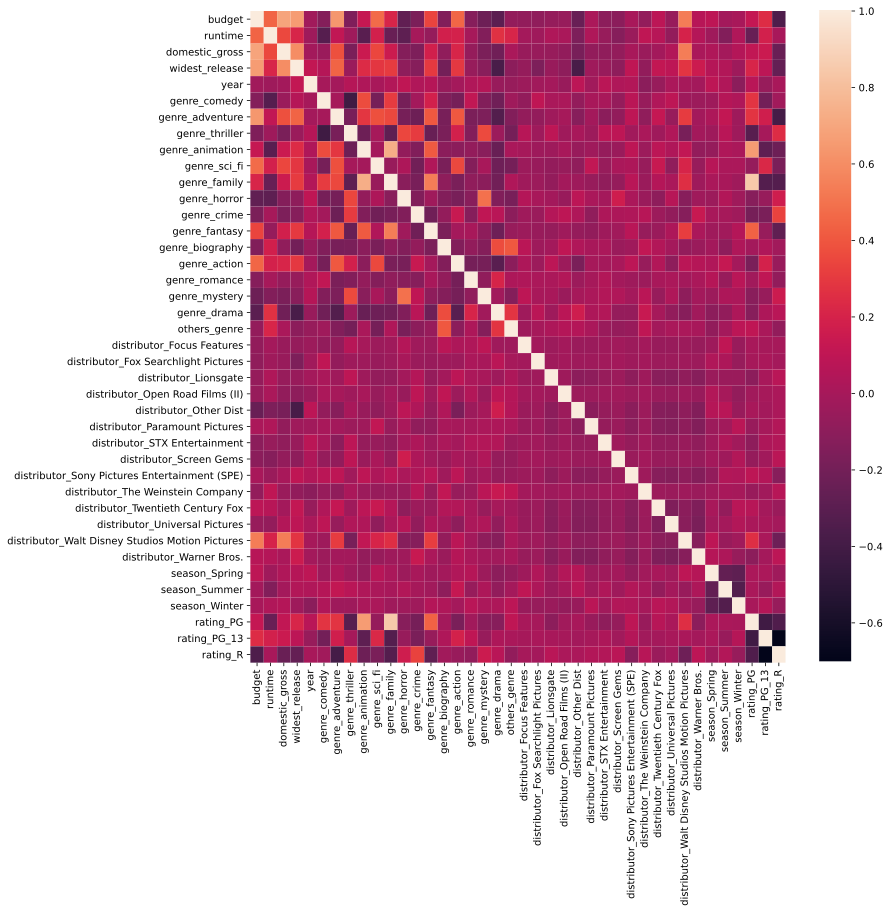

In [11]:
fig, ax = plt.subplots(figsize=(12,12))
sns.heatmap(movies_correlation)
plt.savefig("/Users/hernantrujillo/Documents/Metis/NBM_Regression_Student-main/Movies_Project_Hernan/features_correlation.png", bbox_inches='tight')


In [12]:
#Visualization codes examples

'''sns.regplot(x=df6['budget'], y=df6['domestic_gross'])

sns.pairplot(df6, x_vars=['runtime', \
                           'budget','widest_release'], \
             y_vars='domestic_gross', height=3, aspect=0.8);

sns.histplot(master_df_copy, x="opening_gross");
plt.hist(master_df_copy_7['widest_release']);

sns.pairplot(core_data)

sns.heatmap(movies_correlations)'''

'sns.regplot(x=df6[\'budget\'], y=df6[\'domestic_gross\'])\n\nsns.pairplot(df6, x_vars=[\'runtime\',                            \'budget\',\'widest_release\'],              y_vars=\'domestic_gross\', height=3, aspect=0.8);\n\nsns.histplot(master_df_copy, x="opening_gross");\nplt.hist(master_df_copy_7[\'widest_release\']);\n\nsns.pairplot(core_data)\n\nsns.heatmap(movies_correlations)'

In [76]:
df6 = pd.read_csv('/Users/hernantrujillo/Documents/Metis/NBM_Regression_Student-main/Movies_Project_Hernan/data_project/df6.csv') 

In [77]:
df6.head()

,title,budget,runtime,domestic_gross,widest_release,year,genre_comedy,genre_adventure,genre_thriller,genre_animation,...,distributor_Twentieth Century Fox,distributor_Universal Pictures,distributor_Walt Disney Studios Motion Pictures,distributor_Warner Bros.,season_Spring,season_Summer,season_Winter,rating_PG,rating_PG_13,rating_R
0,Avengers: Endgame,356000000,181,858373000,4662,2019,0,1,0,0,...,0,0,1,0,1,0,0,0,1,0
1,The Lion King,260000000,118,543638043,4802,2019,0,1,0,1,...,0,0,1,0,0,1,0,1,0,0
2,Toy Story 4,200000000,100,434038008,4575,2019,1,1,0,1,...,0,0,1,0,0,1,0,0,0,0
3,Frozen II,150000000,103,477373578,4440,2019,1,1,0,1,...,0,0,1,0,0,0,0,1,0,0
4,Captain Marvel,160000000,123,426829839,4310,2019,0,1,0,0,...,0,0,1,0,1,0,0,0,1,0


In [78]:
#set the title as index

df6.set_index('title', inplace=True)
df6.head()

,budget,runtime,domestic_gross,widest_release,year,genre_comedy,genre_adventure,genre_thriller,genre_animation,genre_sci_fi,...,distributor_Twentieth Century Fox,distributor_Universal Pictures,distributor_Walt Disney Studios Motion Pictures,distributor_Warner Bros.,season_Spring,season_Summer,season_Winter,rating_PG,rating_PG_13,rating_R
title,,,,,,,,,,,,,,,,,,,,,
Avengers: Endgame,356000000,181,858373000,4662,2019,0,1,0,0,1,...,0,0,1,0,1,0,0,0,1,0
The Lion King,260000000,118,543638043,4802,2019,0,1,0,1,0,...,0,0,1,0,0,1,0,1,0,0
Toy Story 4,200000000,100,434038008,4575,2019,1,1,0,1,0,...,0,0,1,0,0,1,0,0,0,0
Frozen II,150000000,103,477373578,4440,2019,1,1,0,1,0,...,0,0,1,0,0,0,0,1,0,0
Captain Marvel,160000000,123,426829839,4310,2019,0,1,0,0,1,...,0,0,1,0,1,0,0,0,1,0


In [105]:
df6.columns

Index(['budget', 'runtime', 'domestic_gross', 'widest_release', 'year',
       'genre_comedy', 'genre_adventure', 'genre_thriller', 'genre_animation',
       'genre_sci_fi', 'genre_family', 'genre_horror', 'genre_crime',
       'genre_fantasy', 'genre_biography', 'genre_action', 'genre_romance',
       'genre_mystery', 'genre_drama', 'others_genre',
       'distributor_Focus Features', 'distributor_Fox Searchlight Pictures',
       'distributor_Lionsgate', 'distributor_Open Road Films (II)',
       'distributor_Other Dist', 'distributor_Paramount Pictures',
       'distributor_STX Entertainment', 'distributor_Screen Gems',
       'distributor_Sony Pictures Entertainment (SPE)',
       'distributor_The Weinstein Company',
       'distributor_Twentieth Century Fox', 'distributor_Universal Pictures',
       'distributor_Walt Disney Studios Motion Pictures',
       'distributor_Warner Bros.', 'season_Spring', 'season_Summer',
       'season_Winter', 'rating_PG', 'rating_PG_13', 'rating_R',

In [62]:
df6_genres = df6[['domestic_gross', 'genre_comedy', 'genre_adventure', 'genre_thriller', 'genre_animation',
       'genre_sci_fi', 'genre_family', 'genre_horror', 'genre_crime',
       'genre_fantasy', 'genre_biography', 'genre_action', 'genre_romance',
       'genre_mystery', 'genre_drama', 'others_genre']]

In [63]:
df6_genres.head()

,domestic_gross,genre_comedy,genre_adventure,genre_thriller,genre_animation,genre_sci_fi,genre_family,genre_horror,genre_crime,genre_fantasy,genre_biography,genre_action,genre_romance,genre_mystery,genre_drama,others_genre
title,,,,,,,,,,,,,,,,
Avengers: Endgame,858373000,0,1,0,0,1,0,0,0,0,0,1,0,0,1,0
The Lion King,543638043,0,1,0,1,0,1,0,0,0,0,0,0,0,1,1
Toy Story 4,434038008,1,1,0,1,0,1,0,0,1,0,0,0,0,0,0
Frozen II,477373578,1,1,0,1,0,1,0,0,1,0,0,0,0,0,1
Captain Marvel,426829839,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0


In [64]:
genres_correlations = df6_genres.corr()
genres_correlations

,domestic_gross,genre_comedy,genre_adventure,genre_thriller,genre_animation,genre_sci_fi,genre_family,genre_horror,genre_crime,genre_fantasy,genre_biography,genre_action,genre_romance,genre_mystery,genre_drama,others_genre
domestic_gross,1.000000,-0.049866,0.380582,-0.171625,0.143828,0.341911,0.149366,-0.134105,-0.163446,0.174904,-0.086854,0.211213,-0.065183,-0.165354,-0.216301,0.011352
genre_comedy,-0.049866,1.000000,-0.003331,-0.421994,0.361133,-0.190396,0.305782,-0.187505,-0.012709,0.185535,-0.146585,-0.190544,0.107730,-0.141995,-0.216278,-0.027740
genre_adventure,0.380582,-0.003331,1.000000,-0.180070,0.287546,0.377311,0.349255,-0.187841,-0.227597,0.403903,-0.182131,0.403544,-0.166700,-0.164185,-0.334263,-0.140184
genre_thriller,-0.171625,-0.421994,-0.180070,1.000000,-0.228624,0.000941,-0.288618,0.343351,0.307046,-0.249335,-0.172117,0.185409,-0.144214,0.358608,-0.038595,-0.191665
genre_animation,0.143828,0.361133,0.287546,-0.228624,1.000000,-0.011340,0.733431,-0.072553,-0.148859,0.408647,-0.111095,-0.109474,-0.076724,-0.116299,-0.245735,0.010244
genre_sci_fi,0.341911,-0.190396,0.377311,0.000941,-0.011340,1.000000,-0.056495,0.026432,-0.207587,0.037917,-0.171877,0.348241,-0.135377,0.002964,-0.222383,-0.195922
genre_family,0.149366,0.305782,0.349255,-0.288618,0.733431,-0.056495,1.000000,-0.113294,-0.181865,0.535637,-0.098122,-0.174046,-0.087875,-0.105423,-0.206774,0.031097
genre_horror,-0.134105,-0.187505,-0.187841,0.343351,-0.072553,0.026432,-0.113294,1.000000,-0.149296,-0.030088,-0.140408,-0.179598,-0.112946,0.489736,-0.150347,-0.183570
genre_crime,-0.163446,-0.012709,-0.227597,0.307046,-0.148859,-0.207587,-0.181865,-0.149296,1.000000,-0.216452,-0.075633,0.130248,-0.126216,0.097083,0.074381,-0.104455
genre_fantasy,0.174904,0.185535,0.403903,-0.249335,0.408647,0.037917,0.535637,-0.030088,-0.216452,1.000000,-0.170070,-0.006574,0.005353,-0.092413,-0.224485,-0.059643


In [22]:
#sns.pairplot(df6_genres)

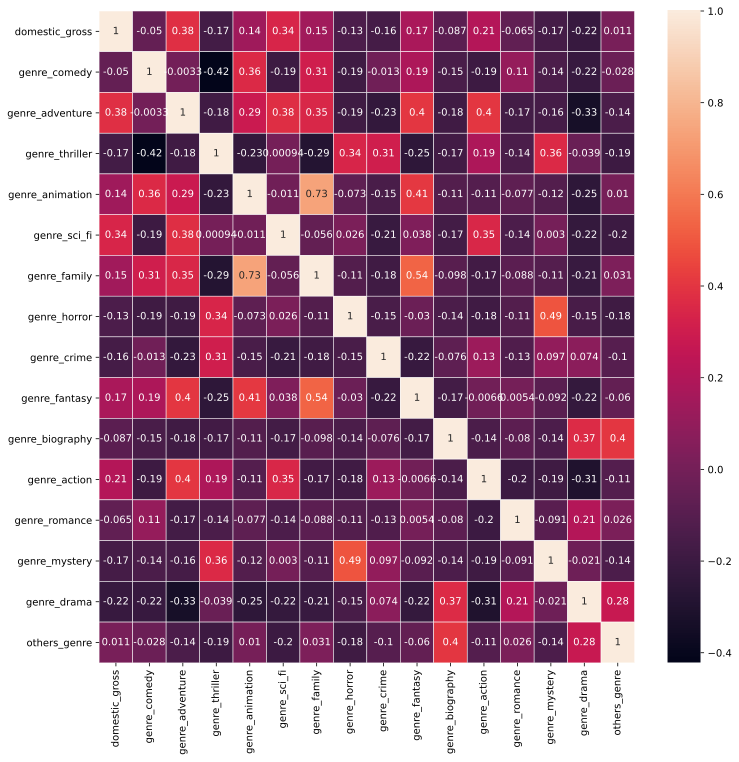

In [106]:
fig, ax = plt.subplots(figsize=(12,12))
sns.heatmap(genres_correlations, annot=True, linewidths=.5, ax=ax)
plt.savefig("/Users/hernantrujillo/Documents/Metis/NBM_Regression_Student-main/Movies_Project_Hernan/genre_heatmap.png", bbox_inches='tight');

In [66]:
df6_distributors = df6[['domestic_gross', 
       'distributor_Focus Features', 'distributor_Fox Searchlight Pictures',
       'distributor_Lionsgate', 'distributor_Open Road Films (II)',
       'distributor_Other Dist', 'distributor_Paramount Pictures',
       'distributor_STX Entertainment', 'distributor_Screen Gems',
       'distributor_Sony Pictures Entertainment (SPE)',
       'distributor_The Weinstein Company',
       'distributor_Twentieth Century Fox', 'distributor_Universal Pictures',
       'distributor_Walt Disney Studios Motion Pictures',
       'distributor_Warner Bros.']]

In [67]:
df6_distributors.head()

,domestic_gross,distributor_Focus Features,distributor_Fox Searchlight Pictures,distributor_Lionsgate,distributor_Open Road Films (II),distributor_Other Dist,distributor_Paramount Pictures,distributor_STX Entertainment,distributor_Screen Gems,distributor_Sony Pictures Entertainment (SPE),distributor_The Weinstein Company,distributor_Twentieth Century Fox,distributor_Universal Pictures,distributor_Walt Disney Studios Motion Pictures,distributor_Warner Bros.
title,,,,,,,,,,,,,,,
Avengers: Endgame,858373000,0,0,0,0,0,0,0,0,0,0,0,0,1,0
The Lion King,543638043,0,0,0,0,0,0,0,0,0,0,0,0,1,0
Toy Story 4,434038008,0,0,0,0,0,0,0,0,0,0,0,0,1,0
Frozen II,477373578,0,0,0,0,0,0,0,0,0,0,0,0,1,0
Captain Marvel,426829839,0,0,0,0,0,0,0,0,0,0,0,0,1,0


In [68]:
dist_correlations = df6_distributors.corr()
dist_correlations

,domestic_gross,distributor_Focus Features,distributor_Fox Searchlight Pictures,distributor_Lionsgate,distributor_Open Road Films (II),distributor_Other Dist,distributor_Paramount Pictures,distributor_STX Entertainment,distributor_Screen Gems,distributor_Sony Pictures Entertainment (SPE),distributor_The Weinstein Company,distributor_Twentieth Century Fox,distributor_Universal Pictures,distributor_Walt Disney Studios Motion Pictures,distributor_Warner Bros.
domestic_gross,1.000000,-0.055933,-0.056366,-0.061743,-0.080007,-0.180926,-0.079184,-0.088453,-0.075371,0.006389,-0.050444,-0.015503,0.045187,0.536704,0.011855
distributor_Focus Features,-0.055933,1.000000,-0.014215,-0.041288,-0.017456,-0.046347,-0.045901,-0.028254,-0.021053,-0.044550,-0.016443,-0.052345,-0.057219,-0.039837,-0.058409
distributor_Fox Searchlight Pictures,-0.056366,-0.014215,1.000000,-0.030360,-0.012836,-0.034080,-0.033753,-0.020776,-0.015481,-0.032758,-0.012091,-0.038491,-0.042074,-0.029293,-0.042949
distributor_Lionsgate,-0.061743,-0.041288,-0.030360,1.000000,-0.037281,-0.098984,-0.098033,-0.060342,-0.044964,-0.095146,-0.035118,-0.111794,-0.122204,-0.085080,-0.124745
distributor_Open Road Films (II),-0.080007,-0.017456,-0.012836,-0.037281,1.000000,-0.041849,-0.041447,-0.025512,-0.019010,-0.040226,-0.014847,-0.047265,-0.051666,-0.035971,-0.052740
distributor_Other Dist,-0.180926,-0.046347,-0.034080,-0.098984,-0.041849,1.000000,-0.110044,-0.067735,-0.050473,-0.106803,-0.039421,-0.125491,-0.137176,-0.095504,-0.140028
distributor_Paramount Pictures,-0.079184,-0.045901,-0.033753,-0.098033,-0.041447,-0.110044,1.000000,-0.067085,-0.049988,-0.105777,-0.039042,-0.124286,-0.135858,-0.094587,-0.138683
distributor_STX Entertainment,-0.088453,-0.028254,-0.020776,-0.060342,-0.025512,-0.067735,-0.067085,1.000000,-0.030769,-0.065109,-0.024032,-0.076502,-0.083625,-0.058221,-0.085364
distributor_Screen Gems,-0.075371,-0.021053,-0.015481,-0.044964,-0.019010,-0.050473,-0.049988,-0.030769,1.000000,-0.048516,-0.017907,-0.057005,-0.062313,-0.043383,-0.063609
distributor_Sony Pictures Entertainment (SPE),0.006389,-0.044550,-0.032758,-0.095146,-0.040226,-0.106803,-0.105777,-0.065109,-0.048516,1.000000,-0.037892,-0.120625,-0.131857,-0.091801,-0.134598


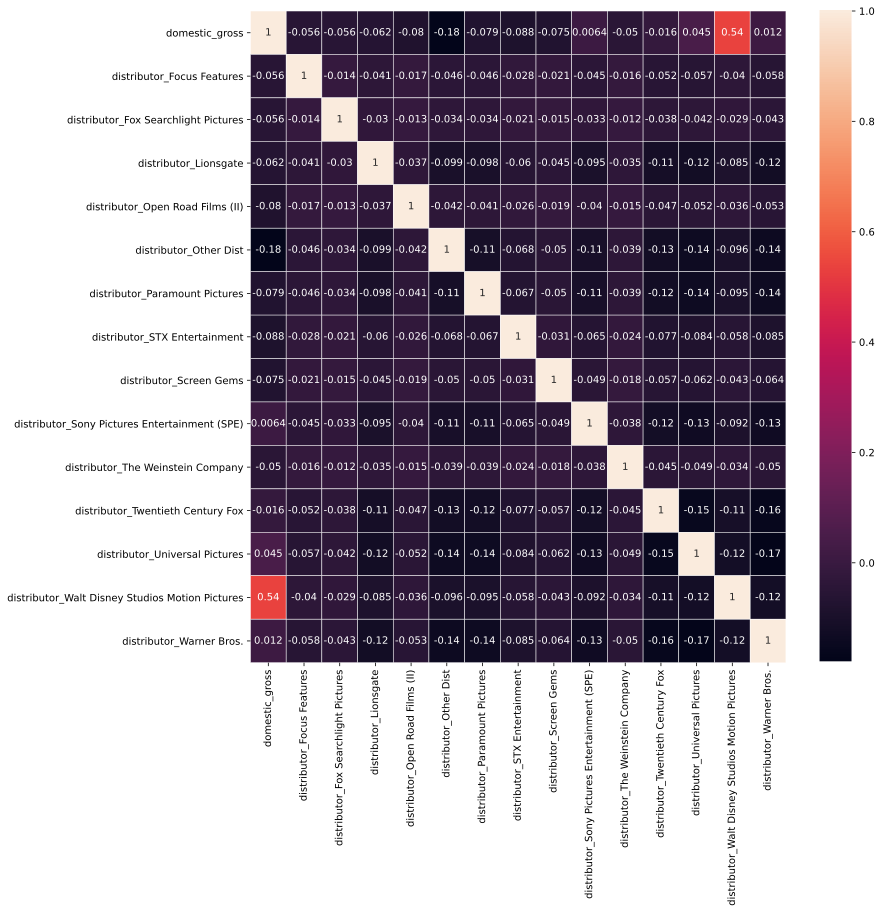

In [114]:
fig, ax = plt.subplots(figsize=(12,12))
sns.heatmap(dist_correlations, annot=True, linewidths=.5, ax=ax)
plt.savefig("/Users/hernantrujillo/Documents/Metis/NBM_Regression_Student-main/Movies_Project_Hernan/distributor_heatmap.png", bbox_inches='tight');

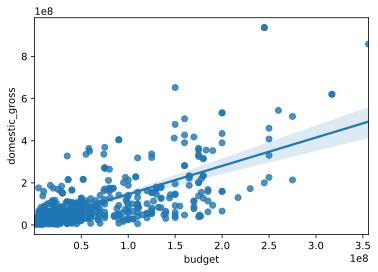

In [108]:
sns.regplot(x=df6['budget'], y=df6['domestic_gross'])
plt.savefig("/Users/hernantrujillo/Documents/Metis/NBM_Regression_Student-main/Movies_Project_Hernan/budget_domesticgross.png", bbox_inches='tight');

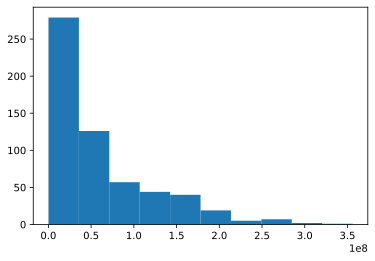

In [109]:
plt.hist(df6['budget']);
plt.savefig("/Users/hernantrujillo/Documents/Metis/NBM_Regression_Student-main/Movies_Project_Hernan/budget_plot.png", bbox_inches='tight');

In [69]:
df6.head()

,budget,runtime,domestic_gross,widest_release,year,genre_comedy,genre_adventure,genre_thriller,genre_animation,genre_sci_fi,...,distributor_Twentieth Century Fox,distributor_Universal Pictures,distributor_Walt Disney Studios Motion Pictures,distributor_Warner Bros.,season_Spring,season_Summer,season_Winter,rating_PG,rating_PG_13,rating_R
title,,,,,,,,,,,,,,,,,,,,,
Avengers: Endgame,356000000,181,858373000,4662,2019,0,1,0,0,1,...,0,0,1,0,1,0,0,0,1,0
The Lion King,260000000,118,543638043,4802,2019,0,1,0,1,0,...,0,0,1,0,0,1,0,1,0,0
Toy Story 4,200000000,100,434038008,4575,2019,1,1,0,1,0,...,0,0,1,0,0,1,0,0,0,0
Frozen II,150000000,103,477373578,4440,2019,1,1,0,1,0,...,0,0,1,0,0,0,0,1,0,0
Captain Marvel,160000000,123,426829839,4310,2019,0,1,0,0,1,...,0,0,1,0,1,0,0,0,1,0


In [70]:
df6.shape

(580, 40)

In [6]:
#sns.regplot(x=df6['widest_release'], y=df6['domestic_gross'])
#plt.savefig("/Users/hernantrujillo/Documents/Metis/NBM_Regression_Student-main/Movies_Project_Hernan/widestrelease_domesticgross.png", bbox_inches='tight');

In [7]:
#sns.pairplot(df6, x_vars=['runtime',\
#                           'budget','widest_release'], \
#             y_vars='domestic_gross', height=6, aspect=0.6, kind='reg', diag_kind = None).savefig("/Users/hernantrujillo/Documents/Metis/NBM_Regression_Student-main/Movies_Project_Hernan/pairplot_features3.png", bbox_inches='tight');


In [8]:

#sns.pairplot(df6).savefig("/Users/hernantrujillo/Documents/Metis/NBM_Regression_Student-main/Movies_Project_Hernan/pairplot_features.png", bbox_inches='tight');

In [9]:
#plt.hist(df6['widest_release'])
#plt.savefig("/Users/hernantrujillo/Documents/Metis/NBM_Regression_Student-main/Movies_Project_Hernan/widest_release_plot.png", bbox_inches='tight');

In [51]:
df6_correlations = df6.corr()
df6_correlations

,budget,runtime,domestic_gross,widest_release,year,genre_comedy,genre_adventure,genre_thriller,genre_animation,genre_sci_fi,...,distributor_Twentieth Century Fox,distributor_Universal Pictures,distributor_Walt Disney Studios Motion Pictures,distributor_Warner Bros.,season_Spring,season_Summer,season_Winter,rating_PG,rating_PG_13,rating_R
budget,1.000000,0.443036,0.689239,0.658882,-0.022903,-0.135760,0.639645,-0.155738,0.126709,0.472797,...,0.084254,-0.063905,0.535793,0.066893,0.089278,-0.017829,0.005094,0.118941,0.241945,-0.352054
runtime,0.443036,1.000000,0.352024,0.208778,-0.035762,-0.320984,0.106270,-0.034872,-0.306652,0.185259,...,0.063674,-0.078158,0.195307,0.053437,-0.030418,-0.138356,0.039046,-0.246626,0.187579,0.005535
domestic_gross,0.689239,0.352024,1.000000,0.595740,-0.013839,-0.049866,0.380582,-0.171625,0.143828,0.341911,...,-0.015503,0.045187,0.536704,0.011855,0.031006,-0.008638,0.051233,0.104210,0.143482,-0.240043
widest_release,0.658882,0.208778,0.595740,1.000000,0.111476,0.055125,0.443547,-0.046356,0.237739,0.286082,...,0.112730,0.089728,0.279146,0.153777,0.056486,0.046950,-0.032927,0.209542,0.085664,-0.260447
year,-0.022903,-0.035762,-0.013839,0.111476,1.000000,-0.001346,-0.010398,0.054866,0.031708,0.003554,...,-0.061388,0.021316,-0.004138,-0.016401,0.090629,0.038133,-0.109772,0.070292,-0.059383,0.005940
genre_comedy,-0.135760,-0.320984,-0.049866,0.055125,-0.001346,1.000000,-0.003331,-0.421994,0.361133,-0.190396,...,0.038389,0.090722,-0.037081,-0.041262,-0.035444,0.056823,0.032961,0.280995,-0.199372,-0.021481
genre_adventure,0.639645,0.106270,0.380582,0.443547,-0.010398,-0.003331,1.000000,-0.180070,0.287546,0.377311,...,0.114911,-0.058643,0.301835,-0.017311,0.022708,0.113265,-0.032161,0.276984,0.171787,-0.394458
genre_thriller,-0.155738,-0.034872,-0.171625,-0.046356,0.054866,-0.421994,-0.180070,1.000000,-0.228624,0.000941,...,-0.026118,0.039486,-0.184505,-0.012380,-0.034345,0.074524,-0.035759,-0.312267,0.000765,0.246423
genre_animation,0.126709,-0.306652,0.143828,0.237739,0.031708,0.361133,0.287546,-0.228624,1.000000,-0.011340,...,0.086491,0.028715,0.102280,-0.073802,-0.071067,0.034583,0.013988,0.654864,-0.291172,-0.229389
genre_sci_fi,0.472797,0.185259,0.341911,0.286082,0.003554,-0.190396,0.377311,0.000941,-0.011340,1.000000,...,0.130416,-0.089247,0.207311,-0.059600,0.067763,0.016586,0.015019,-0.071285,0.223627,-0.171689


In [72]:
df6.columns

Index(['budget', 'runtime', 'domestic_gross', 'widest_release', 'year',
       'genre_comedy', 'genre_adventure', 'genre_thriller', 'genre_animation',
       'genre_sci_fi', 'genre_family', 'genre_horror', 'genre_crime',
       'genre_fantasy', 'genre_biography', 'genre_action', 'genre_romance',
       'genre_mystery', 'genre_drama', 'others_genre',
       'distributor_Focus Features', 'distributor_Fox Searchlight Pictures',
       'distributor_Lionsgate', 'distributor_Open Road Films (II)',
       'distributor_Other Dist', 'distributor_Paramount Pictures',
       'distributor_STX Entertainment', 'distributor_Screen Gems',
       'distributor_Sony Pictures Entertainment (SPE)',
       'distributor_The Weinstein Company',
       'distributor_Twentieth Century Fox', 'distributor_Universal Pictures',
       'distributor_Walt Disney Studios Motion Pictures',
       'distributor_Warner Bros.', 'season_Spring', 'season_Summer',
       'season_Winter', 'rating_PG', 'rating_PG_13', 'rating_R']

In [79]:
df6['title'] = df6.index

In [80]:
df6.head()

,budget,runtime,domestic_gross,widest_release,year,genre_comedy,genre_adventure,genre_thriller,genre_animation,genre_sci_fi,...,distributor_Universal Pictures,distributor_Walt Disney Studios Motion Pictures,distributor_Warner Bros.,season_Spring,season_Summer,season_Winter,rating_PG,rating_PG_13,rating_R,title
title,,,,,,,,,,,,,,,,,,,,,
Avengers: Endgame,356000000,181,858373000,4662,2019,0,1,0,0,1,...,0,1,0,1,0,0,0,1,0,Avengers: Endgame
The Lion King,260000000,118,543638043,4802,2019,0,1,0,1,0,...,0,1,0,0,1,0,1,0,0,The Lion King
Toy Story 4,200000000,100,434038008,4575,2019,1,1,0,1,0,...,0,1,0,0,1,0,0,0,0,Toy Story 4
Frozen II,150000000,103,477373578,4440,2019,1,1,0,1,0,...,0,1,0,0,0,0,1,0,0,Frozen II
Captain Marvel,160000000,123,426829839,4310,2019,0,1,0,0,1,...,0,1,0,1,0,0,0,1,0,Captain Marvel


In [81]:
#Let's make a smaller dataset with the hightest correlation with our target to see if we can visualize some paterns 
#Since it's a predictive model we're excluding Opening gross
#Excluding worldwide gross since it's highly correlated with our target (domestic gross)
#Excluding all negative correlations with our target

smaller_df6 = df6[["title", "domestic_gross", "budget", "runtime", "widest_release", "genre_adventure", "genre_family", "genre_drama", "genre_sci_fi", "distributor_Walt Disney Studios Motion Pictures", "season_Spring", "season_Summer", "season_Winter", "rating_PG", "rating_PG_13"]]
smaller_df6

,title,domestic_gross,budget,runtime,widest_release,genre_adventure,genre_family,genre_drama,genre_sci_fi,distributor_Walt Disney Studios Motion Pictures,season_Spring,season_Summer,season_Winter,rating_PG,rating_PG_13
title,,,,,,,,,,,,,,,
Avengers: Endgame,Avengers: Endgame,858373000,356000000,181,4662,1,0,1,1,1,1,0,0,0,1
The Lion King,The Lion King,543638043,260000000,118,4802,1,1,1,0,1,0,1,0,1,0
Toy Story 4,Toy Story 4,434038008,200000000,100,4575,1,1,0,0,1,0,1,0,0,0
Frozen II,Frozen II,477373578,150000000,103,4440,1,1,0,0,1,0,0,0,1,0
Captain Marvel,Captain Marvel,426829839,160000000,123,4310,1,0,0,1,1,1,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Danny Collins,Danny Collins,5637066,10000000,106,739,0,0,1,0,0,1,0,0,0,0
90 Minutes in Heaven,90 Minutes in Heaven,4842699,5000000,121,899,0,0,1,0,0,0,0,0,0,1
The Water Diviner,The Water Diviner,4196641,22500000,111,385,0,0,1,0,0,1,0,0,0,0


In [82]:
smaller_df6.drop('title', axis=1, inplace=True)

/opt/anaconda3/lib/python3.8/site-packages/pandas/core/frame.py:4163: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


In [85]:
smaller_df6.head()

,domestic_gross,budget,runtime,widest_release,genre_adventure,genre_family,genre_drama,genre_sci_fi,distributor_Walt Disney Studios Motion Pictures,season_Spring,season_Summer,season_Winter,rating_PG,rating_PG_13
title,,,,,,,,,,,,,,
Avengers: Endgame,858373000,356000000,181,4662,1,0,1,1,1,1,0,0,0,1
The Lion King,543638043,260000000,118,4802,1,1,1,0,1,0,1,0,1,0
Toy Story 4,434038008,200000000,100,4575,1,1,0,0,1,0,1,0,0,0
Frozen II,477373578,150000000,103,4440,1,1,0,0,1,0,0,0,1,0
Captain Marvel,426829839,160000000,123,4310,1,0,0,1,1,1,0,0,0,1


In [52]:
import matplotlib.pyplot as plt

In [10]:
#sns.pairplot(smaller_df6) 
#plt.savefig("/Users/hernantrujillo/Documents/Metis/NBM_Regression_Student-main/Movies_Project_Hernan/smaller_pairplot.png");

In [87]:
df6_correlations

,budget,runtime,domestic_gross,widest_release,year,genre_comedy,genre_adventure,genre_thriller,genre_animation,genre_sci_fi,...,distributor_Twentieth Century Fox,distributor_Universal Pictures,distributor_Walt Disney Studios Motion Pictures,distributor_Warner Bros.,season_Spring,season_Summer,season_Winter,rating_PG,rating_PG_13,rating_R
budget,1.000000,0.443036,0.689239,0.658882,-0.022903,-0.135760,0.639645,-0.155738,0.126709,0.472797,...,0.084254,-0.063905,0.535793,0.066893,0.089278,-0.017829,0.005094,0.118941,0.241945,-0.352054
runtime,0.443036,1.000000,0.352024,0.208778,-0.035762,-0.320984,0.106270,-0.034872,-0.306652,0.185259,...,0.063674,-0.078158,0.195307,0.053437,-0.030418,-0.138356,0.039046,-0.246626,0.187579,0.005535
domestic_gross,0.689239,0.352024,1.000000,0.595740,-0.013839,-0.049866,0.380582,-0.171625,0.143828,0.341911,...,-0.015503,0.045187,0.536704,0.011855,0.031006,-0.008638,0.051233,0.104210,0.143482,-0.240043
widest_release,0.658882,0.208778,0.595740,1.000000,0.111476,0.055125,0.443547,-0.046356,0.237739,0.286082,...,0.112730,0.089728,0.279146,0.153777,0.056486,0.046950,-0.032927,0.209542,0.085664,-0.260447
year,-0.022903,-0.035762,-0.013839,0.111476,1.000000,-0.001346,-0.010398,0.054866,0.031708,0.003554,...,-0.061388,0.021316,-0.004138,-0.016401,0.090629,0.038133,-0.109772,0.070292,-0.059383,0.005940
genre_comedy,-0.135760,-0.320984,-0.049866,0.055125,-0.001346,1.000000,-0.003331,-0.421994,0.361133,-0.190396,...,0.038389,0.090722,-0.037081,-0.041262,-0.035444,0.056823,0.032961,0.280995,-0.199372,-0.021481
genre_adventure,0.639645,0.106270,0.380582,0.443547,-0.010398,-0.003331,1.000000,-0.180070,0.287546,0.377311,...,0.114911,-0.058643,0.301835,-0.017311,0.022708,0.113265,-0.032161,0.276984,0.171787,-0.394458
genre_thriller,-0.155738,-0.034872,-0.171625,-0.046356,0.054866,-0.421994,-0.180070,1.000000,-0.228624,0.000941,...,-0.026118,0.039486,-0.184505,-0.012380,-0.034345,0.074524,-0.035759,-0.312267,0.000765,0.246423
genre_animation,0.126709,-0.306652,0.143828,0.237739,0.031708,0.361133,0.287546,-0.228624,1.000000,-0.011340,...,0.086491,0.028715,0.102280,-0.073802,-0.071067,0.034583,0.013988,0.654864,-0.291172,-0.229389
genre_sci_fi,0.472797,0.185259,0.341911,0.286082,0.003554,-0.190396,0.377311,0.000941,-0.011340,1.000000,...,0.130416,-0.089247,0.207311,-0.059600,0.067763,0.016586,0.015019,-0.071285,0.223627,-0.171689


In [11]:
#fig, ax = plt.subplots(figsize=(12,12))
#sns.heatmap(df6_correlations);
#plt.savefig("/Users/hernantrujillo/Documents/Metis/NBM_Regression_Student-main/Movies_Project_Hernan/heatmap_correlations.png");

In [12]:
#df_small = df6.loc[:,["domestic_gross", "budget", "runtime", "widest_release"]]

#sns.pairplot(df_small).savefig("/Users/hernantrujillo/Documents/Metis/NBM_Regression_Student-main/Movies_Project_Hernan/pairplot_small.png", bbox_inches='tight')

In [91]:
df6.head()

,budget,runtime,domestic_gross,widest_release,year,genre_comedy,genre_adventure,genre_thriller,genre_animation,genre_sci_fi,...,distributor_Universal Pictures,distributor_Walt Disney Studios Motion Pictures,distributor_Warner Bros.,season_Spring,season_Summer,season_Winter,rating_PG,rating_PG_13,rating_R,title
title,,,,,,,,,,,,,,,,,,,,,
Avengers: Endgame,356000000,181,858373000,4662,2019,0,1,0,0,1,...,0,1,0,1,0,0,0,1,0,Avengers: Endgame
The Lion King,260000000,118,543638043,4802,2019,0,1,0,1,0,...,0,1,0,0,1,0,1,0,0,The Lion King
Toy Story 4,200000000,100,434038008,4575,2019,1,1,0,1,0,...,0,1,0,0,1,0,0,0,0,Toy Story 4
Frozen II,150000000,103,477373578,4440,2019,1,1,0,1,0,...,0,1,0,0,0,0,1,0,0,Frozen II
Captain Marvel,160000000,123,426829839,4310,2019,0,1,0,0,1,...,0,1,0,1,0,0,0,1,0,Captain Marvel


In [13]:
#plt.hist(df6['domestic_gross'])
#plt.savefig("/Users/hernantrujillo/Documents/Metis/NBM_Regression_Student-main/Movies_Project_Hernan/domestic_gross.png", bbox_inches='tight');

In [97]:
smaller_df6.to_csv('/Users/hernantrujillo/Documents/Metis/NBM_Regression_Student-main/Movies_Project_Hernan/data_project/smaller_df6.csv') 

In [98]:
smaller_df6 = pd.read_csv('/Users/hernantrujillo/Documents/Metis/NBM_Regression_Student-main/Movies_Project_Hernan/data_project/smaller_df6.csv')

In [99]:
smaller_df6

,Unnamed: 0,title,domestic_gross,budget,runtime,widest_release,genre_adventure,genre_family,genre_drama,genre_sci_fi,distributor_Walt Disney Studios Motion Pictures,season_Spring,season_Summer,season_Winter,rating_PG,rating_PG_13
0,0,Avengers: Endgame,858373000,356000000,181,4662,1,0,1,1,1,1,0,0,0,1
1,1,The Lion King,543638043,260000000,118,4802,1,1,1,0,1,0,1,0,1,0
2,2,Toy Story 4,434038008,200000000,100,4575,1,1,0,0,1,0,1,0,0,0
3,3,Frozen II,477373578,150000000,103,4440,1,1,0,0,1,0,0,0,1,0
4,4,Captain Marvel,426829839,160000000,123,4310,1,0,0,1,1,1,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
575,575,Danny Collins,5637066,10000000,106,739,0,0,1,0,0,1,0,0,0,0
576,576,90 Minutes in Heaven,4842699,5000000,121,899,0,0,1,0,0,0,0,0,0,1
577,577,The Water Diviner,4196641,22500000,111,385,0,0,1,0,0,1,0,0,0,0
578,578,Scouts Guide to the Zombie Apocalypse,3703046,15000000,93,1509,0,0,0,0,0,0,0,0,0,0


In [104]:
movies_budget = smaller_df6.loc[:, ["title", "domestic_gross", "season_Winter"]]
group_movies = movies_budget.groupby(["title"]).sum()

#Descending movie titles by domestic_gross
group_movies.sort_values(by="domestic_gross", ascending=False)

,domestic_gross,season_Winter
title,,
Star Wars: Episode VII - The Force Awakens,1873324450,2
Star Wars: Episode VIII - The Last Jedi,1240362764,2
Rogue One: A Star Wars Story,1064354648,2
Avengers: Endgame,858373000,0
Jumanji: Welcome to the Jungle,809030960,2
...,...,...
Friend Request,3759078,0
Scouts Guide to the Zombie Apocalypse,3703046,0
Rules Don't Apply,3652206,0
